In [1]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import savgol_filter
import umap
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
import torch.optim as optim

from torchvision.utils import make_grid

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
import os
os.chdir('../IConNet/')
os.getcwd()

'/home/linh/projects/IConNet'

In [5]:
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"
import gc
import sys
import numpy as np
from tqdm import tqdm

In [6]:
dataset_name = 'ravdess'
model_dir = f'../scb7_models/{dataset_name}/'

In [7]:
data_dir = f'../data/data_preprocessed/{dataset_name}/preprocessed/'
sr = 16000

data_x = np.load(f'{data_dir}{dataset_name}.audio16k.npy', allow_pickle=True)
data_y = np.load(f'{data_dir}{dataset_name}.label_emotion.npy', allow_pickle=True)
classnames = np.load(f'{data_dir}{dataset_name}.classnames.npy', allow_pickle=True)
print(classnames)
print(data_x.shape)
print(data_y.shape)
np.unique(data_y)

['neutral' 'calm' 'happy' 'sad' 'angry' 'fearful' 'disgust' 'surprised']
(1440,)
(1440,)


array([0, 1, 2, 3, 4, 5, 6, 7])

In [8]:
labels = ['ang', 'neu', 'sad', 'hap']

def label_filter(idx):
    return classnames[idx][:3] in labels

def label_to_index(idx):
    return labels.index(classnames[idx][:3])
    
filtered_idx = [label_filter(idx) for idx in data_y]
data_x = data_x[filtered_idx]
data_y = [label_to_index(idx) for idx in data_y[filtered_idx]]
print(data_x.shape)

(672,)


In [9]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(
    data_x, data_y, test_size=0.2, 
    random_state=42, stratify=data_y)
print("Train: %i" % len(x_train))
print("Test: %i" % len(x_test))
train_set = list(zip(x_train, y_train))
test_set = list(zip(x_test, y_test))

Train: 537
Test: 135


In [10]:
def pad_sequence(batch):
    # Make all tensor in a batch the same length by padding with zeros
    batch = [item.t() for item in batch]
    batch = torch.nn.utils.rnn.pad_sequence(
        batch, batch_first=True, padding_value=0.).permute(0, 2, 1)
    return batch

def collate_fn(batch, max_duration_in_second=3, sample_rate=sr):
    tensors, targets = [], []

    # Gather in lists, and encode labels as indices
    for waveform, label in batch:
        if max_duration_in_second is not None:
            waveform = np.array(waveform, dtype=float).squeeze()
            length = len(waveform)
            max_length = sample_rate * max_duration_in_second
            offset = max(0, (length - max_length) // 2)
            waveform = waveform[offset: length-offset]
        tensors += [torch.tensor(waveform, dtype=torch.float32)[None,:]]
        targets += [torch.tensor(label, dtype=torch.long)]

    # Group the list of tensors into a batched tensor
    tensors = pad_sequence(tensors)
    targets = torch.stack(targets)
    return tensors, targets

batch_size = 16

if device == "cuda":
    num_workers = 1
    pin_memory = True
else:
    num_workers = 0
    pin_memory = False

train_loader = torch.utils.data.DataLoader(
    train_set,
    batch_size=batch_size,
    shuffle=True,
    collate_fn=collate_fn,
    num_workers=num_workers,
    pin_memory=pin_memory, 
    drop_last=True
)
test_loader = torch.utils.data.DataLoader(
    test_set,
    batch_size=batch_size,
    shuffle=False,
    drop_last=True,
    collate_fn=collate_fn,
    num_workers=num_workers,
    pin_memory=pin_memory
)

In [11]:
from IConNet.acov.zero_crossing import (
    zero_crossings, zero_crossing_rate, 
    zero_crossing_score, samples_like,
    signal_distortion_ratio, signal_loss)
from IConNet.nn.activation import gumbel_softmax

In [12]:
from einops import rearrange

class VectorQuantizer(nn.Module):
    """
    TODO: RVQ, L_ortho, DWT loss?
    """
    def __init__(self, num_embeddings, embedding_dim, commitment_cost):
        super(VectorQuantizer, self).__init__()

        self.embedding_dim = embedding_dim
        self.num_embeddings = num_embeddings

        self.embedding = nn.Embedding(self.num_embeddings, self.embedding_dim)
        self.embedding.weight.data.uniform_(
            -1/self.num_embeddings, 1/self.num_embeddings)
        self.commitment_cost = commitment_cost

    def forward(self, inputs):
        eps = torch.finfo(inputs.dtype).eps
        device = inputs.device
        inputs = rearrange(
            inputs, 'b h c k -> b h c k', k=self.embedding_dim)

        flat_input = inputs.view(-1, self.embedding_dim)
        distances = (torch.sum(flat_input**2, dim=1, keepdim=True)
                    + torch.sum(self.embedding.weight**2, dim=1)
                    - 2 * torch.matmul(flat_input, self.embedding.weight.t()))

        encoding_indices = torch.argmin(distances, dim=1, keepdim=True)
        encodings = torch.zeros(
            encoding_indices.shape[0], 
            self.num_embeddings, 
            device=device)
        encodings.scatter_(1, encoding_indices, 1)

        quantized = torch.matmul(
            encodings, self.embedding.weight).view(inputs.shape)
        
        e_latent_loss = F.mse_loss(quantized.detach(), inputs)
        q_latent_loss = F.mse_loss(quantized, inputs.detach())
        loss = q_latent_loss + self.commitment_cost * e_latent_loss

        quantized = inputs + (quantized - inputs).detach()
        avg_probs = torch.mean(encodings, dim=0)
        perplexity = torch.exp(-torch.sum(avg_probs * torch.log(avg_probs + eps)))
        return loss, quantized, perplexity, encodings

In [13]:
from typing import Literal
import torch 
from torch import nn, Tensor
from torch.nn import functional as F
from einops import rearrange, reduce, repeat

class LocalPatternFilter(nn.Module):
    def __init__(
        self, 
        in_channels: int, 
        out_channels: int, 
        kernel_size: int=1023,
        filter_selection_mode: Literal['fixed', 'auto']='auto'
    ) -> None:
        """
        filter_selection_mode:
            - `fixed`: linspace
            - `zerocrossing`: zerocrossing with gumbel softmax selection 
        """
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.kernel_size = kernel_size
        self.filter_selection_mode = filter_selection_mode
        self.position_concentration = nn.Parameter(torch.rand(self.out_channels))  
        self.pad_layer = PadForConv(
                    kernel_size=self.kernel_size,
                    pad_mode='zero')

    @staticmethod
    def compute_autocovariance(
            X: Tensor,
            positions,
            kernel_size) -> Tensor:
        acov = []
        for position in positions:
            end_pos = position + kernel_size
            frame = X[..., position:end_pos]
            acov += [self.autocovariance(frame)]
        return torch.stack(acov, dim=1)

    @staticmethod
    def autocovariance(filters: Tensor) -> Tensor:
        eps = torch.finfo(filters.dtype).eps
        n = filters.shape[-1]
        filters_max = reduce(filters.abs(), '... n -> ... ()', 'max')
        filters_max = torch.where(filters_max == 0, eps, filters_max)
        win = torch.hann_window(
            window_length=n, 
            dtype=filters.dtype, device=filters.device)
        windowed_data = filters * win / filters_max # normalize
        spectrum = torch.fft.rfft(windowed_data, n=n)**2
        acov = torch.fft.ifftshift(torch.fft.irfft(spectrum.abs(), n=n))
        return acov

    @staticmethod
    def random_filter_positions(
        X: Tensor,
        n_positions: int,
        kernel_size: int,
        end: int,
        mode: Literal['fixed', 'auto']='fixed',
    ):
        if mode=='fixed':
            positions = repeat(
                torch.linspace(
                    start=0, 
                    end=end,
                    steps=n_positions,
                    dtype=torch.int,
                    device=X.device),
                'h -> b h', b=X.shape[0]
            )
        else: # auto: based on zerocrossing
            scores = zero_crossing_score(
                X, n_fft=kernel_size, stride=kernel_size//4)
            scores = gumbel_softmax(scores, tau=1)
            samples = samples_like(
                scores, 
                n_fft=kernel_size, 
                stride=kernel_size//4,
                offset=0, 
                max_sample=end,
                keepdim=False) # (T)
            
            frame_positions = torch.topk(
                scores, n_positions, dim=-1).indices.sort().values
            
            positions = []
            for frame_pos in frame_positions.split(1):
                frame_pos = frame_pos.squeeze()
                positions += [samples.index_select(dim=0, index=frame_pos)]
            positions = torch.stack(positions, dim=0) 
        return positions.contiguous()

    def _generate_filters_idx(self, X: Tensor) -> Tensor:
        length = X.shape[-1]
        end = length - self.kernel_size - 1 - self.kernel_size # TODO: check why -kernel
        n_positions = self.out_channels
        positions = self.random_filter_positions(
            X, n_positions, self.kernel_size,
            end, self.filter_selection_mode)
        positions = rearrange(positions, '... t -> ... t 1')
        filters_idx = torch.concat(
            [positions + i for i in range(self.kernel_size)], 
            dim=-1)
        return filters_idx
        
    def _extract_filters(
        self, X: Tensor, filters_idx: Tensor) -> Tensor:
        filters = []
        b, h, n = filters_idx.shape
        for i in range(b):
            filter = []
            for j in range(h):
                filter += [X[i].index_select(dim=-1, index=filters_idx[i, j, :])]
            filter = torch.stack(filter, dim=0)
            filters.append(filter)
        filters = torch.stack(filters, dim=0).contiguous()
        return filters
        
    def _generate_filters(self, X) -> Tensor:
        filters_idx = self._generate_filters_idx(self.pad_layer(X))
        filters = self._extract_filters(X, filters_idx)
        filters = self.autocovariance(filters)
        return filters
    
    def forward(self, X: Tensor) -> Tensor:
        batch_size = X.shape[0]
        filters = self._generate_filters(X)
        assert filters.shape == (batch_size,
                                 self.out_channels, 
                                 self.in_channels, 
                                 self.kernel_size)
        return filters

    

In [14]:
class FilterEnhance(nn.Module):
    def __init__(
        self, 
        in_channels,
        out_channels):
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        
    def forward(self, X, filters):
        recon_loss = torch.tensor(0., dtype=torch.float64, requires_grad=True)
        n_outputs = self.out_channels
        n_batch = X.shape[0]
        for i in range(n_batch):
            X_outs = F.conv1d(
                X, filters[i], padding='same').chunk(n_outputs, dim=1)
            loss = torch.tensor(0., dtype=torch.float64, requires_grad=True)
            for k in range(n_outputs):
                loss = loss + signal_loss(X, X_outs[k])
            recon_loss = recon_loss + loss / n_outputs
        return recon_loss.sum()

In [15]:
from IConNet.conv.pad import PadForConv
from IConNet.nn.mamba import FeedForward, MambaBlock

In [16]:
num_training_updates = 1000
log_interval = 100
test_interval = 100

in_channels = 1
out_channels = 8
embedding_dim = 1023
num_embeddings = 384

commitment_cost = 0.25

learning_rate = 1e-3
num_tokens = 256
num_classes = 4

In [17]:
from IConNet.acov.visualize import (
    visualize_speech_codebook, get_embedding_color, 
    visualize_embedding_umap, visualize_training_curves,
    get_embedding_color_v2
)

In [18]:
from einops import rearrange

class Model(nn.Module):
    def __init__(
        self,
        in_channels: int, 
        out_channels: int,         
        num_embeddings: int, 
        embedding_dim: int, 
        commitment_cost: float,
        num_tokens: int, 
        num_classes: int, 
        filter_selection_mode: Literal['fixed', 'auto']='auto'
    ):
        super(Model, self).__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.num_embeddings = num_embeddings
        self.embedding_dim = embedding_dim
        self.num_tokens = num_tokens
        self.cls_features = num_embeddings
        self.num_classes = num_classes

        self.encoder = LocalPatternFilter(
            in_channels = in_channels,
            out_channels = out_channels,
            filter_selection_mode=filter_selection_mode
        )
        self.vq_vae = VectorQuantizer(
            num_embeddings, embedding_dim, commitment_cost)
        self.decoder = FilterEnhance(
            in_channels = in_channels,
            out_channels = out_channels
        )
        self.ffn = FeedForward(self.num_embeddings)
        self.ln1 = nn.LayerNorm(self.num_embeddings)
        self.cls_head = nn.Linear(
            self.cls_features, num_classes)
        self.pad_layer = PadForConv(
                    kernel_size=self.num_tokens,
                    pad_mode='mean')

    @staticmethod
    def get_embedding_color_v2(
            y: Tensor, 
            mask_ratio=0.2, 
            score_offset=0.5) -> Tensor:
        y = y / repeat(reduce(y, 'b n -> b' , 'max'), 'b -> b n', n=1)
        crossings = zero_crossings(y, dtype=torch.float)
        zcrate = crossings.mean(dim=-1)
        length = y.shape[-1]
        mid_q = length//4   # length//16 * 5
        crossings_mid = crossings[:, mid_q:-mid_q]
        nonzero_mean = torch.where(
            crossings>0, crossings, 0.0).mean(dim=-1)
        nonzero_mean_mid = torch.where(
            crossings_mid>0, crossings_mid, 0.0).mean(dim=-1)
        kernel_size = (length + 1) // 8
        y_pos_avg = F.avg_pool1d(
            torch.clamp(y, min=0), 
            kernel_size=kernel_size, stride=kernel_size)
        emb_data_cond = torch.diff(y_pos_avg) > 0
        cond1 = emb_data_cond[:, 1:3].sum(dim=-1) == 2
        cond2 = emb_data_cond[:, -2:].sum(dim=-1) == 0
        cond3 = y_pos_avg[:, 3] - y_pos_avg[:, -1] > 0
        cond4 = y_pos_avg[:, 4] - y_pos_avg[:, 0] > 0
        emb_data_mask = cond1 * cond2 * cond3 * cond4
        score0 = F.sigmoid(1 - 8*zcrate + nonzero_mean + nonzero_mean_mid)
        score1 = mask_ratio * emb_data_mask
        score = score0 + score1*(1-score0) - score_offset
        score_sig = torch.clamp(
            F.softplus(score, beta=40.0, threshold=0.5)*10, max=1)
        
        # color = torch.stack(
        #     [torch.full_like(score, 0.5), score_sig, score_sig], 
        #     dim=-1).numpy()
        # return color, score
        return score

    def generate_embedding_mask(self):
        """
        TODO: 
            replace > 0 with actvation func or learnable weights
            act(zcs)
            act(zcs*w)
        """
        emb_data = self.vq_vae.embedding.weight
        kernel_size = (self.embedding_dim + 1) // 8
        zcs = self.get_embedding_color_v2(self.embedding_filters)
        return rearrange(zcs > 0, 'c -> 1 c 1')
        

    @property
    def embedding_filters(self):
        return self.vq_vae.embedding.weight

    def project(self, X):
        filters = repeat(
            self.embedding_filters,
            'h n -> h c n', c=self.in_channels)
        X = F.conv1d(X, filters)
        embedding_mask = self.generate_embedding_mask()
        return X * embedding_mask

    def classify(self, X):
        X = reduce(rearrange(self.pad_layer(X), 
                      'b h (l t) -> b l t h', l=self.num_tokens),
                  'b l t h -> b l h', 'max')
        X = reduce(self.ffn(self.ln1(X)),
                     'b l h -> b h', 'mean')
        X = self.cls_head(X)
        return X

    def forward(self, X):
        Z = self.encoder(X)
        vq_loss, Z_quantized, perplexity, _ = self.vq_vae(Z)
        recon_loss = self.decoder(X, Z_quantized)
        logits = self.classify(self.project(X))
        return logits, vq_loss, recon_loss, perplexity

In [19]:
model = Model(in_channels, out_channels,
              num_embeddings, embedding_dim,
              commitment_cost, num_tokens, 
              num_classes, filter_selection_mode='auto').to(device)

In [20]:
optimizer = optim.Adam(model.parameters(), lr=learning_rate, amsgrad=False)

In [21]:
test_loader_length = len(test_loader.dataset)

@torch.no_grad()
def test(model, iter):
    model.eval()
    correct = 0
    for data, target in test_loader:
        data = data.to(device)
        target = target.to(device)
        logits, _,_,_ = model(data)
        del data
        gc.collect()
        torch.cuda.empty_cache()
        probs = F.softmax(logits.squeeze(), dim=-1)
        pred = probs.argmax(dim=-1)
        correct += pred.eq(target).sum().item()
        del target
        gc.collect()
        torch.cuda.empty_cache()
    acc = correct / test_loader_length
    print(f"Test iter: {iter}\tAccuracy: {correct}/{test_loader_length} ({100. * acc:.0f}%)\n")
    return acc

In [22]:
from torchmetrics.classification import (
    MulticlassAccuracy, MulticlassPrecision, 
    MulticlassRecall, MulticlassF1Score, 
    MulticlassConfusionMatrix,
    MulticlassAUROC
)
from torchmetrics import MetricCollection
from pprint import pprint

@torch.no_grad
def report_metrics(model, labels=labels, 
                   test_loader=test_loader, device=device):
    n = len(labels)
    metrics = MetricCollection({
        'acc_unweighted': MulticlassAccuracy(num_classes=n), 
        'acc_weighted': MulticlassAccuracy(num_classes=n, average='weighted'), 
        
        'f1s': MulticlassF1Score(num_classes=n),  
        'uar': MulticlassRecall(num_classes=n, average='macro'), 
        'wap': MulticlassPrecision(num_classes=n, average='weighted'),
        
        'f1s_detail': MulticlassF1Score(num_classes=n, average=None),  
        'acc_detail': MulticlassAccuracy(num_classes=n, average=None), 
        'precision_detail': MulticlassPrecision(num_classes=n, average=None),
        'recall_detail': MulticlassRecall(num_classes=n, average=None), 
        'rocauc': MulticlassAUROC(num_classes=n, average=None, thresholds=None)
    }
    # , compute_groups=[['acc', 'f1s', 'wap'], ['uap', 'uar']]
                              ).to(device)
    confusion_matrix = MulticlassConfusionMatrix(num_classes=n).to(device)
    model.eval()
    correct = 0
    total = 0
    for data, target in test_loader:
        total += len(target)
        
        data = data.to(device)
        target = target.to(device)
        logits, _,_,_ = model(data)
        del data
        gc.collect()
        torch.cuda.empty_cache()
        probs = F.softmax(logits.squeeze(), dim=-1)
        pred = probs.argmax(dim=-1)
        correct += pred.eq(target).sum().item()
        
        metrics.update(probs, target)
        confusion_matrix.update(pred, target)
        
        del target
        gc.collect()
        torch.cuda.empty_cache()
    print(f'Correct: {correct}/{total} ({correct/total:.4f})')
    return metrics, confusion_matrix

In [24]:
model.train()
train_res_recon_error = []
train_res_perplexity = []
train_res_cls_loss = []
test_accuracy = []
best_acc = 0

for i in range(num_training_updates):
    (data, target) = next(iter(train_loader))
    data = data.to(device)
    target = target.to(device)
    optimizer.zero_grad()

    logits, vq_loss, recon_loss, perplexity = model(data)
    cls_loss = F.cross_entropy(logits.squeeze(), target)
    loss = vq_loss + recon_loss + 0.15*cls_loss
    loss.backward()
    optimizer.step()

    train_res_recon_error.append(recon_loss.item())
    train_res_perplexity.append(perplexity.item())
    train_res_cls_loss.append(cls_loss.item())

    del data, target
    gc.collect()
    torch.cuda.empty_cache() 

    if (i+1) % log_interval == 0:
        print('%d iterations' % (i+1))
        print('cls_loss: %.3f' % np.mean(train_res_cls_loss[-log_interval:]))
        print('recon_error: %.3f' % np.mean(train_res_recon_error[-log_interval:]))
        print('perplexity: %.3f' % np.mean(train_res_perplexity[-log_interval:]))
        print()

    if (i+1) % test_interval == 0:
        model.eval()
        acc = test(model, i+1)
        test_accuracy.append(acc)
        if acc > best_acc:
            best_acc = acc
            model_path = f'{model_dir}scb7.model.{dataset_name}.step{i+1}.pt'
            torch.save(model.state_dict(), model_path)
            metrics, confusion_matrix = report_metrics(
                model, labels=labels, device=device)
            pprint(metrics.compute())
            pprint(confusion_matrix.compute())
        model.train()

100 iterations
cls_loss: 0.994
recon_error: 46.746
perplexity: 25.194

Test iter: 100	Accuracy: 63/135 (47%)

Correct: 63/128 (0.4922)
{'acc_detail': tensor([0.8750, 0.0556, 0.6923, 0.1795], device='cuda:0'),
 'acc_unweighted': tensor(0.4506, device='cuda:0'),
 'acc_weighted': tensor(0.4922, device='cuda:0'),
 'f1s': tensor(0.3959, device='cuda:0'),
 'f1s_detail': tensor([0.6512, 0.0909, 0.6000, 0.2414], device='cuda:0'),
 'precision_detail': tensor([0.5185, 0.2500, 0.5294, 0.3684], device='cuda:0'),
 'recall_detail': tensor([0.8750, 0.0556, 0.6923, 0.1795], device='cuda:0'),
 'rocauc': tensor([0.9089, 0.8328, 0.8228, 0.6687], device='cuda:0'),
 'uar': tensor(0.4506, device='cuda:0'),
 'wap': tensor(0.4383, device='cuda:0')}
tensor([[28,  0,  2,  2],
        [ 5,  1,  9,  3],
        [ 3,  2, 27,  7],
        [18,  1, 13,  7]], device='cuda:0')
200 iterations
cls_loss: 0.878
recon_error: 45.946
perplexity: 24.588

Test iter: 200	Accuracy: 73/135 (54%)

Correct: 73/128 (0.5703)
{'acc_de

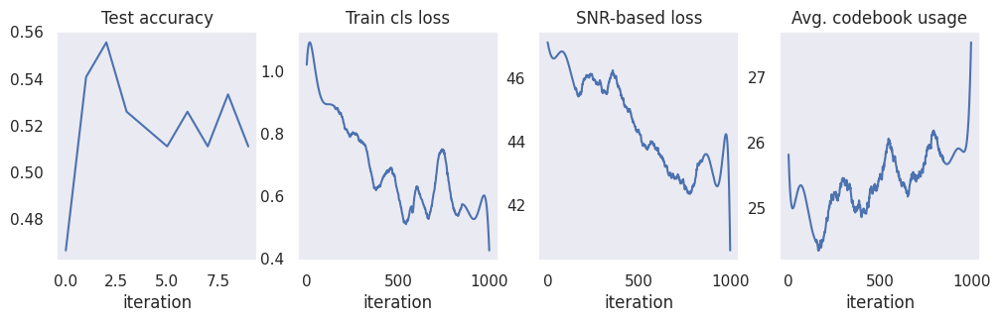

In [25]:
visualize_training_curves(
    test_accuracy, train_res_cls_loss,
    train_res_recon_error, train_res_perplexity
)

In [26]:
emb_data = model.vq_vae.embedding.weight.data.cpu()
emb_color, zcs = get_embedding_color_v2(emb_data)

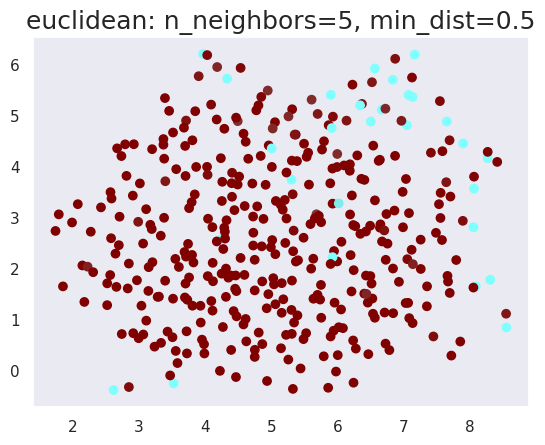

In [28]:
k = 5
min_dist = 0.5
umap_metric = 'euclidean'
visualize_embedding_umap(emb_data, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

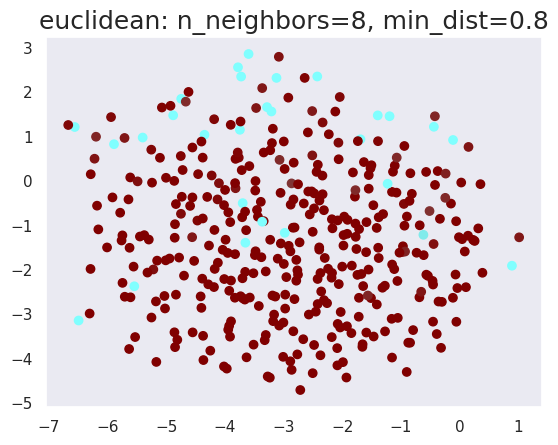

In [30]:
k = 8
min_dist = 0.8
umap_metric = 'euclidean'
visualize_embedding_umap(emb_data, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

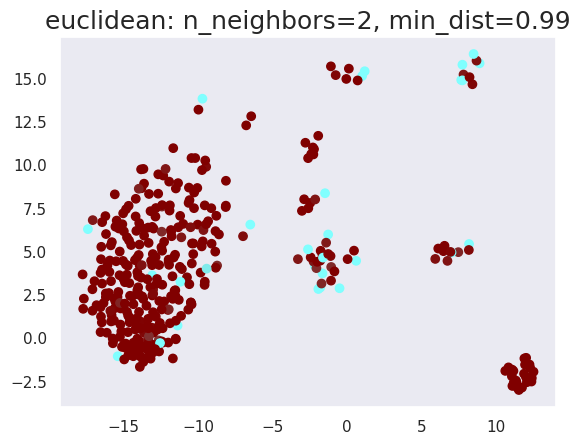

In [29]:
k = 2
min_dist = 0.99
umap_metric = 'euclidean'
visualize_embedding_umap(emb_data, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

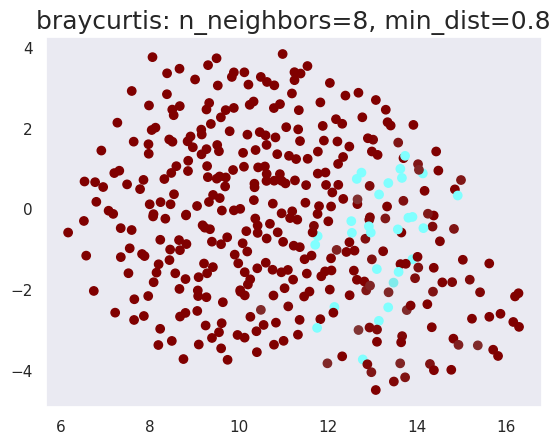

In [31]:
k = 8
min_dist = 0.8
umap_metric = 'braycurtis'
visualize_embedding_umap(emb_data, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

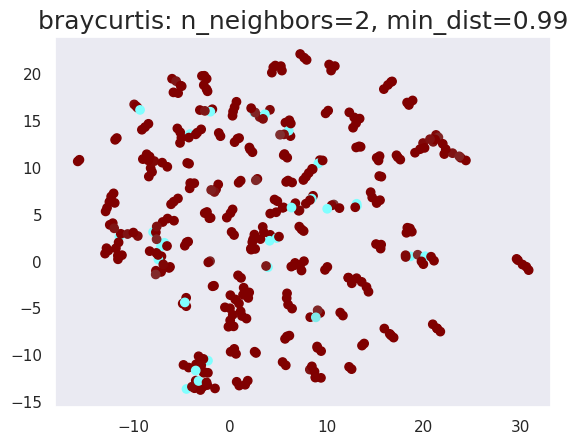

In [32]:
k = 2
min_dist = 0.99
umap_metric = 'braycurtis'
visualize_embedding_umap(emb_data, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

/opt/anaconda3/envs/audio/lib/python3.9/site-packages/librosa/feature/spectral.py:2143: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)


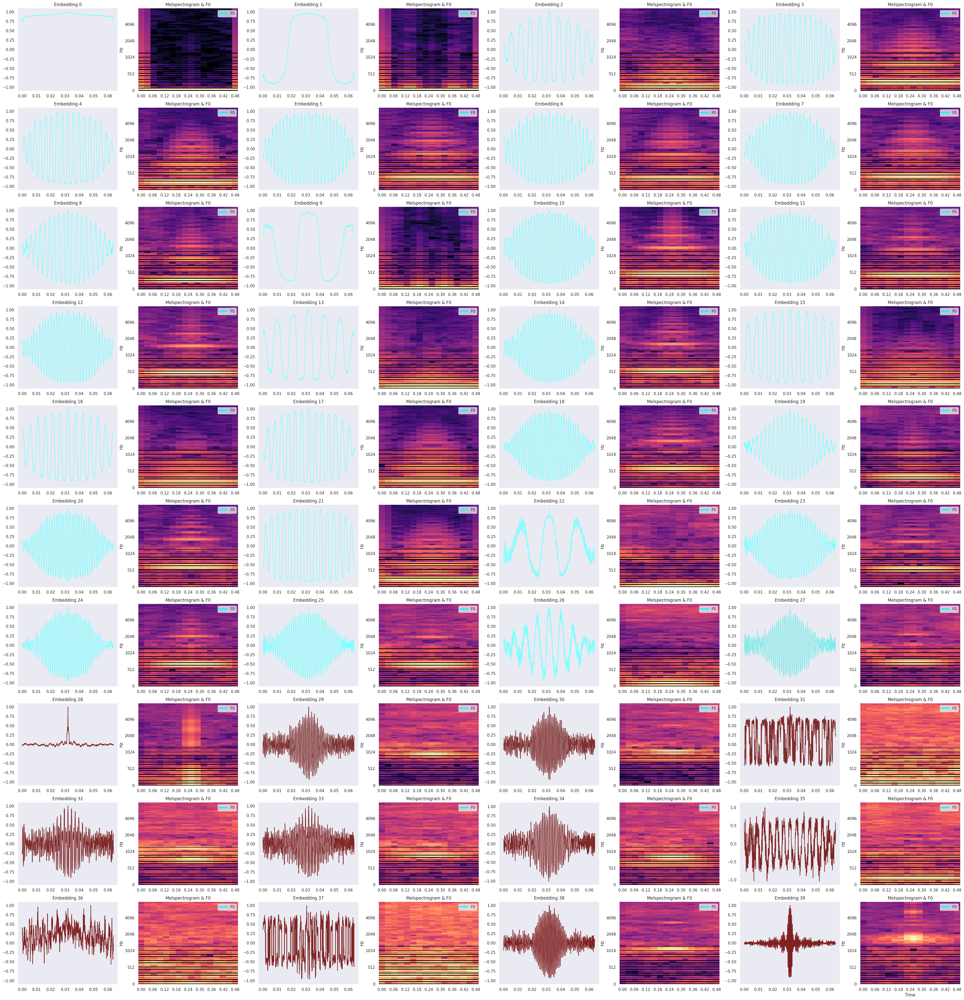

In [34]:
selected_emb_topk = torch.topk(zcs, 40)
selected_idx = selected_emb_topk.indices
visualize_speech_codebook(
    emb_data[selected_idx].numpy(), 
    n=80, colors=emb_color[selected_idx])

In [35]:
selected_emb_topk

torch.return_types.topk(
values=tensor([ 0.2848,  0.2833,  0.2636,  0.2501,  0.2494,  0.2361,  0.2354,  0.2315,
         0.2267,  0.2264,  0.2228,  0.2196,  0.2185,  0.2142,  0.2142,  0.2045,
         0.2025,  0.2004,  0.1991,  0.1971,  0.1960,  0.1947,  0.1731,  0.1630,
         0.1486,  0.1247,  0.1003,  0.0923,  0.0163,  0.0059,  0.0031, -0.0007,
        -0.0020, -0.0035, -0.0036, -0.0047, -0.0062, -0.0062, -0.0084, -0.0108]),
indices=tensor([ 46, 210, 379, 303,  13,  47,  83, 141, 282, 134, 182, 238, 225, 190,
         44, 270,  77, 131, 169, 207, 283, 148, 133, 252,  55,   5, 174, 377,
         67,  20, 172, 193, 221, 362, 360, 380, 201, 202, 308, 369]))

In [36]:
num_training_updates = 1000
additional_steps = 9000
for i in range(num_training_updates, num_training_updates+additional_steps):
    (data, target) = next(iter(train_loader))
    data = data.to(device)
    target = target.to(device)
    optimizer.zero_grad()

    logits, vq_loss, recon_loss, perplexity = model(data)
    cls_loss = F.cross_entropy(logits.squeeze(), target)
    loss = vq_loss + recon_loss + 0.15*cls_loss
    loss.backward()
    optimizer.step()

    train_res_recon_error.append(recon_loss.item())
    train_res_perplexity.append(perplexity.item())
    train_res_cls_loss.append(cls_loss.item())

    del data, target
    gc.collect()
    torch.cuda.empty_cache() 

    if (i+1) % log_interval == 0:
        print('%d iterations' % (i+1))
        print('cls_loss: %.3f' % np.mean(train_res_cls_loss[-log_interval:]))
        print('recon_error: %.3f' % np.mean(train_res_recon_error[-log_interval:]))
        print('perplexity: %.3f' % np.mean(train_res_perplexity[-log_interval:]))
        print()

    if (i+1) % test_interval == 0:
        model.eval()
        acc = test(model, i+1)
        test_accuracy.append(acc)
        if acc > best_acc:
            best_acc = acc
            model_path = f'{model_dir}scb7.model.{dataset_name}.step{i+1}.pt'
            torch.save(model.state_dict(), model_path)
            metrics, confusion_matrix = report_metrics(
                model, labels=labels, device=device)
            pprint(metrics.compute())
            pprint(confusion_matrix.compute())
        model.train()

1100 iterations
cls_loss: 0.450
recon_error: 42.425
perplexity: 26.429

Test iter: 1100	Accuracy: 74/135 (55%)

1200 iterations
cls_loss: 0.351
recon_error: 42.260
perplexity: 26.635

Test iter: 1200	Accuracy: 77/135 (57%)

Correct: 77/128 (0.6016)
{'acc_detail': tensor([0.8125, 0.7778, 0.5641, 0.3846], device='cuda:0'),
 'acc_unweighted': tensor(0.6347, device='cuda:0'),
 'acc_weighted': tensor(0.6016, device='cuda:0'),
 'f1s': tensor(0.6051, device='cuda:0'),
 'f1s_detail': tensor([0.7647, 0.6222, 0.6111, 0.4225], device='cuda:0'),
 'precision_detail': tensor([0.7222, 0.5185, 0.6667, 0.4688], device='cuda:0'),
 'recall_detail': tensor([0.8125, 0.7778, 0.5641, 0.3846], device='cuda:0'),
 'rocauc': tensor([0.9541, 0.9056, 0.8084, 0.7159], device='cuda:0'),
 'uar': tensor(0.6347, device='cuda:0'),
 'wap': tensor(0.5994, device='cuda:0')}
tensor([[26,  0,  1,  5],
        [ 1, 14,  2,  1],
        [ 0,  6, 22, 11],
        [ 9,  7,  8, 15]], device='cuda:0')
1300 iterations
cls_loss: 0.3

In [38]:
metrics, confusion_matrix = report_metrics(
    model, labels=labels, device=device)
pprint(metrics.compute())
pprint(confusion_matrix.compute())

Correct: 85/128 (0.6641)
{'acc_detail': tensor([0.8438, 0.6111, 0.6923, 0.5128], device='cuda:0'),
 'acc_unweighted': tensor(0.6650, device='cuda:0'),
 'acc_weighted': tensor(0.6641, device='cuda:0'),
 'f1s': tensor(0.6572, device='cuda:0'),
 'f1s_detail': tensor([0.8182, 0.5789, 0.6835, 0.5479], device='cuda:0'),
 'precision_detail': tensor([0.7941, 0.5500, 0.6750, 0.5882], device='cuda:0'),
 'recall_detail': tensor([0.8438, 0.6111, 0.6923, 0.5128], device='cuda:0'),
 'rocauc': tensor([0.9505, 0.9071, 0.8341, 0.7799], device='cuda:0'),
 'uar': tensor(0.6650, device='cuda:0'),
 'wap': tensor(0.6608, device='cuda:0')}
tensor([[27,  0,  1,  4],
        [ 0, 11,  4,  3],
        [ 0,  5, 27,  7],
        [ 7,  4,  8, 20]], device='cuda:0')


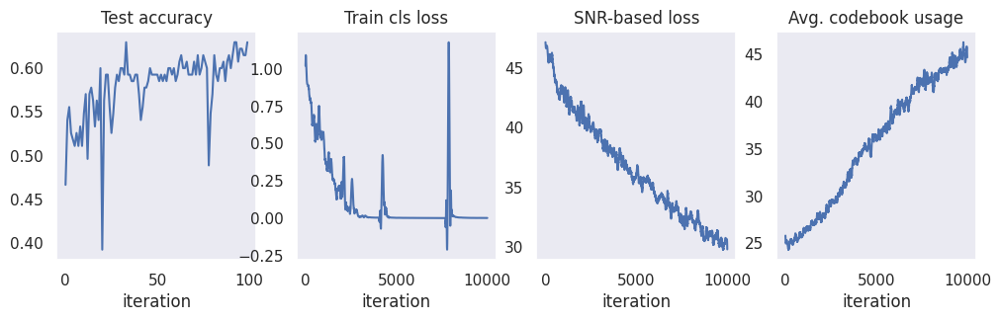

In [39]:
visualize_training_curves(
    test_accuracy, train_res_cls_loss,
    train_res_recon_error, train_res_perplexity
)

In [41]:
model_path = f'{model_dir}scb7.model.{dataset_name}.step{i+1}.pt'
print(model_path)
torch.save(model.state_dict(), model_path)

../scb7_models/ravdess/scb7.model.ravdess.step10000.pt


In [44]:
emb_data2 = model.vq_vae.embedding.weight.data.cpu()
emb_color2, zcs2 = get_embedding_color_v2(emb_data2)

In [45]:
sum(zcs2>0)

tensor(115)

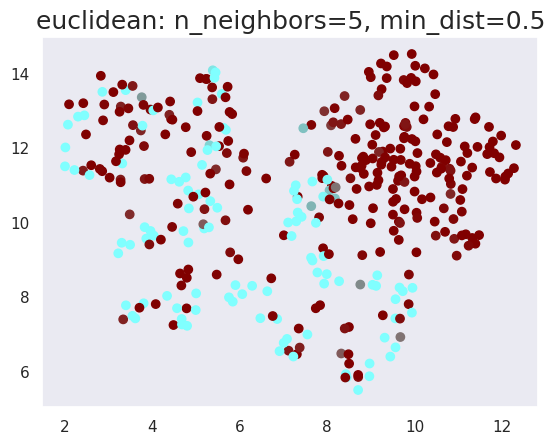

In [46]:
k = 5
min_dist = 0.5
umap_metric = 'euclidean'
visualize_embedding_umap(emb_data2, colors=emb_color2, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

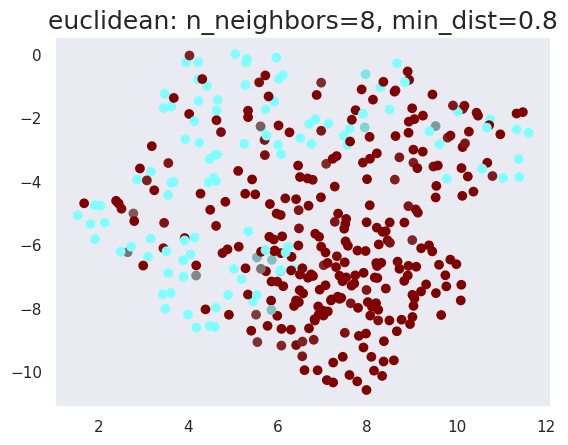

In [47]:
k = 8
min_dist = 0.8
umap_metric = 'euclidean'
visualize_embedding_umap(emb_data2, colors=emb_color2, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

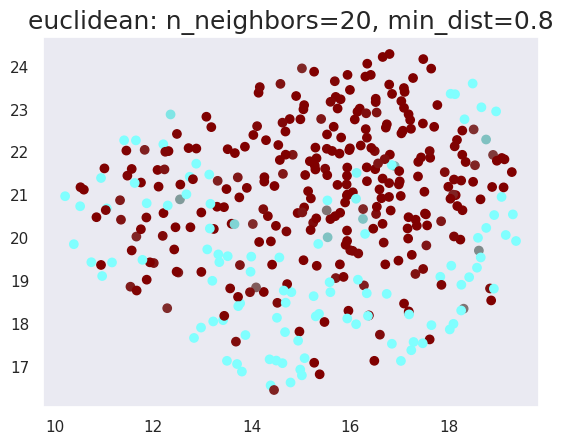

In [56]:
k = 20
min_dist = 0.8
umap_metric = 'euclidean'
visualize_embedding_umap(emb_data2, colors=emb_color2, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

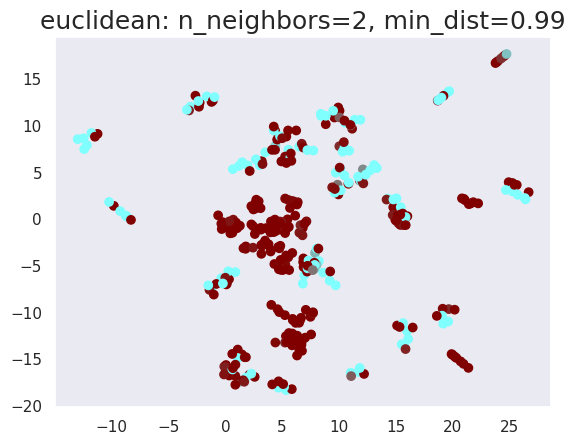

In [48]:
k = 2
min_dist = 0.99
umap_metric = 'euclidean'
visualize_embedding_umap(emb_data2, colors=emb_color2, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

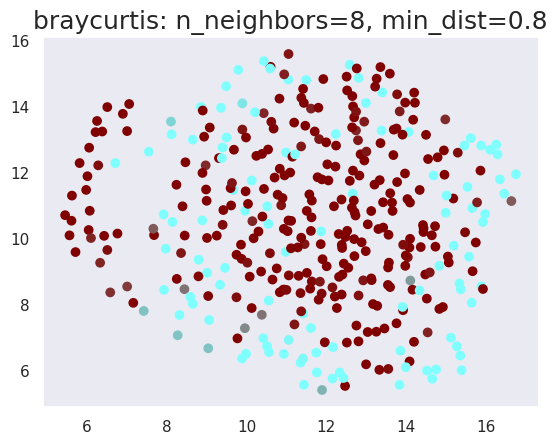

In [49]:
k = 8
min_dist = 0.8
umap_metric = 'braycurtis'
visualize_embedding_umap(emb_data2, colors=emb_color2, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

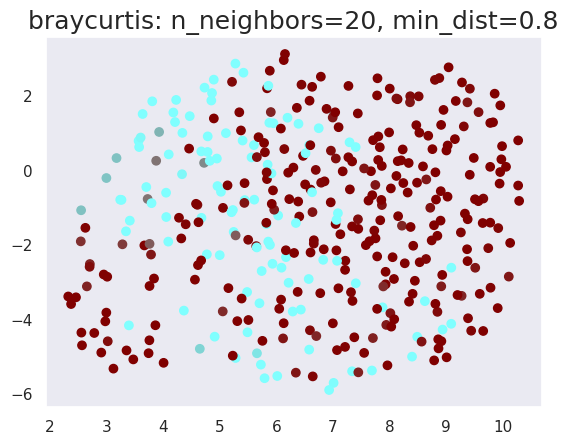

In [55]:
k = 20
min_dist = 0.8
umap_metric = 'braycurtis'
visualize_embedding_umap(emb_data2, colors=emb_color2, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

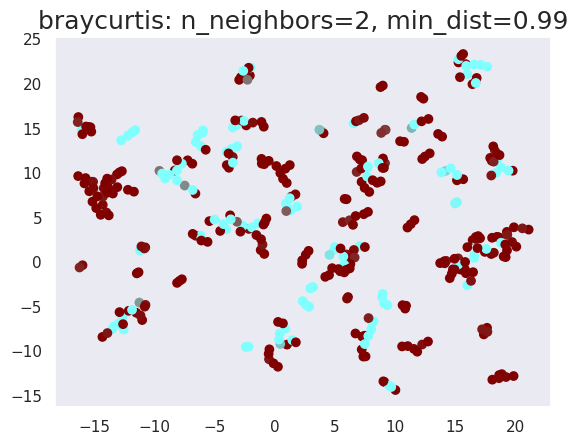

In [50]:
k = 2
min_dist = 0.99
umap_metric = 'braycurtis'
visualize_embedding_umap(emb_data2, colors=emb_color2, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

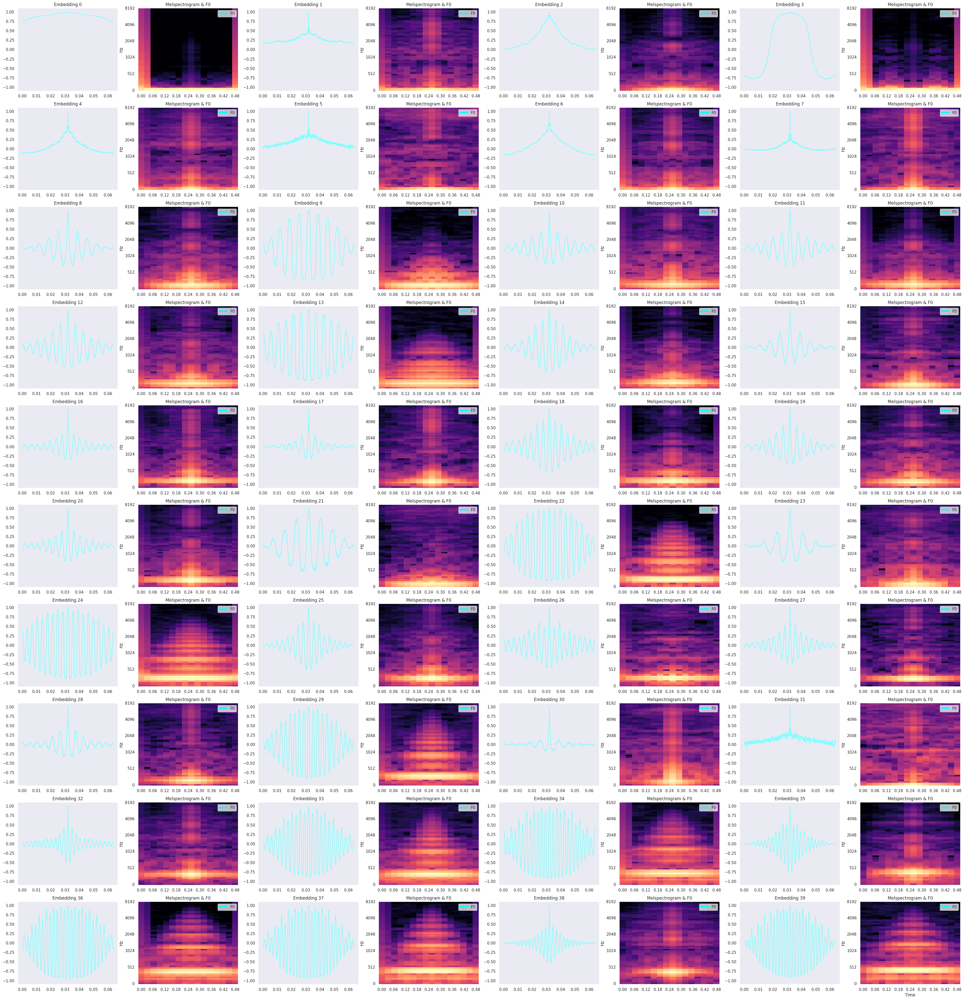

In [57]:
selected_idx = torch.topk(zcs2, 40).indices
visualize_speech_codebook(
    emb_data2[selected_idx].numpy(), 
    n=80, colors=emb_color2[selected_idx])

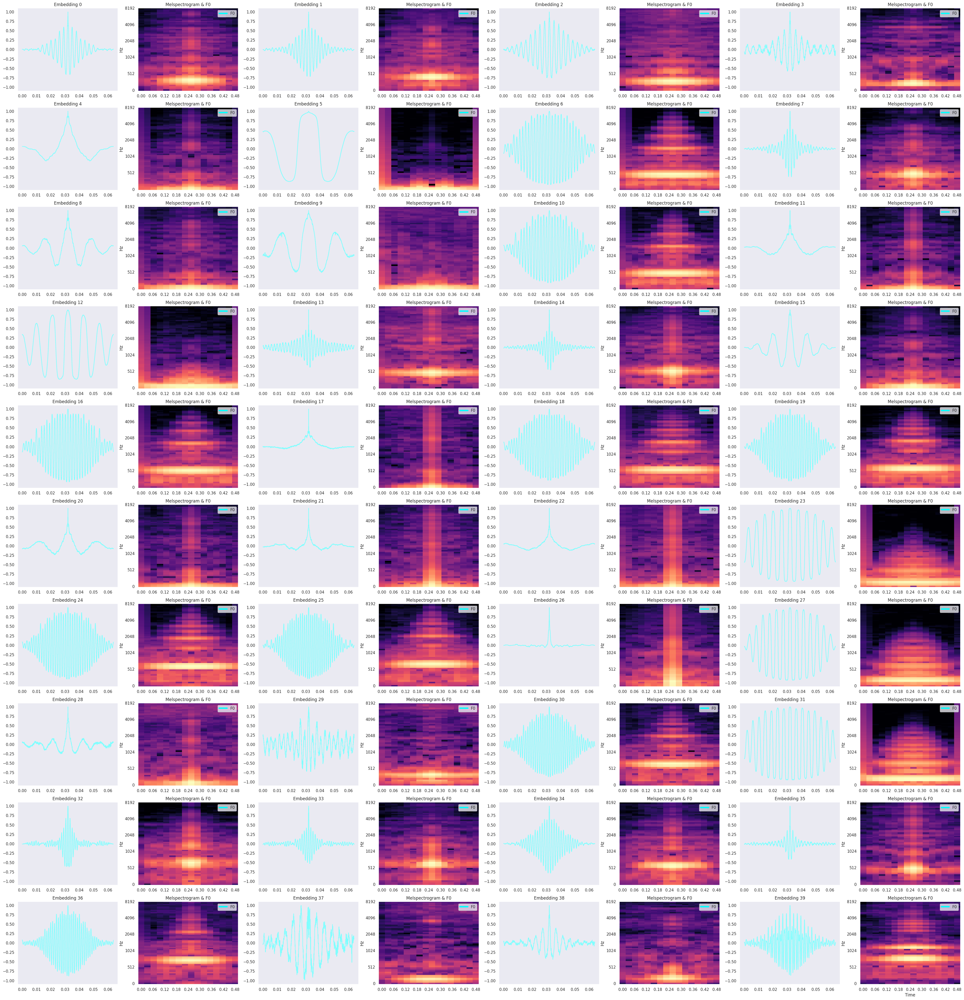

In [58]:
selected_idx = torch.topk(zcs2, 80).indices[40:]
visualize_speech_codebook(
    emb_data2[selected_idx].numpy(), 
    n=80, colors=emb_color2[selected_idx])

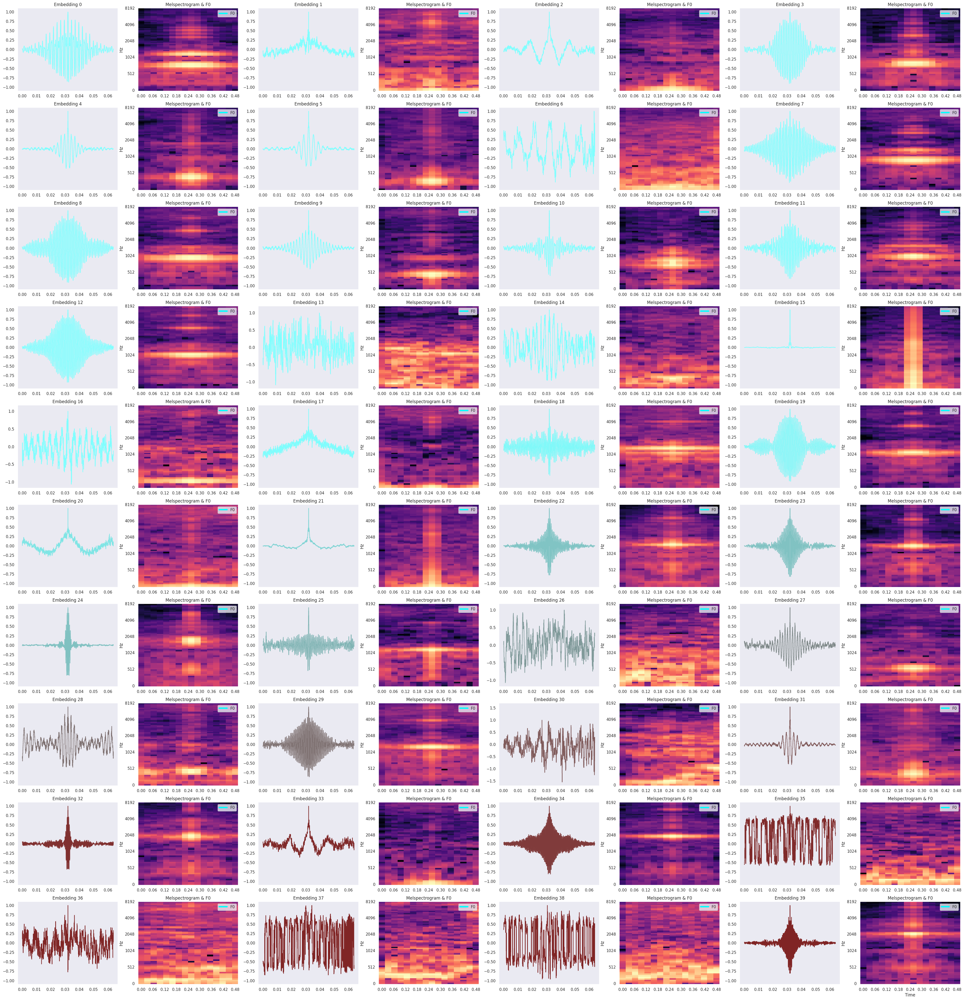

In [59]:
selected_idx = torch.topk(zcs2, 120).indices[-40:]
visualize_speech_codebook(
    emb_data2[selected_idx].numpy(), 
    n=80, colors=emb_color2[selected_idx])

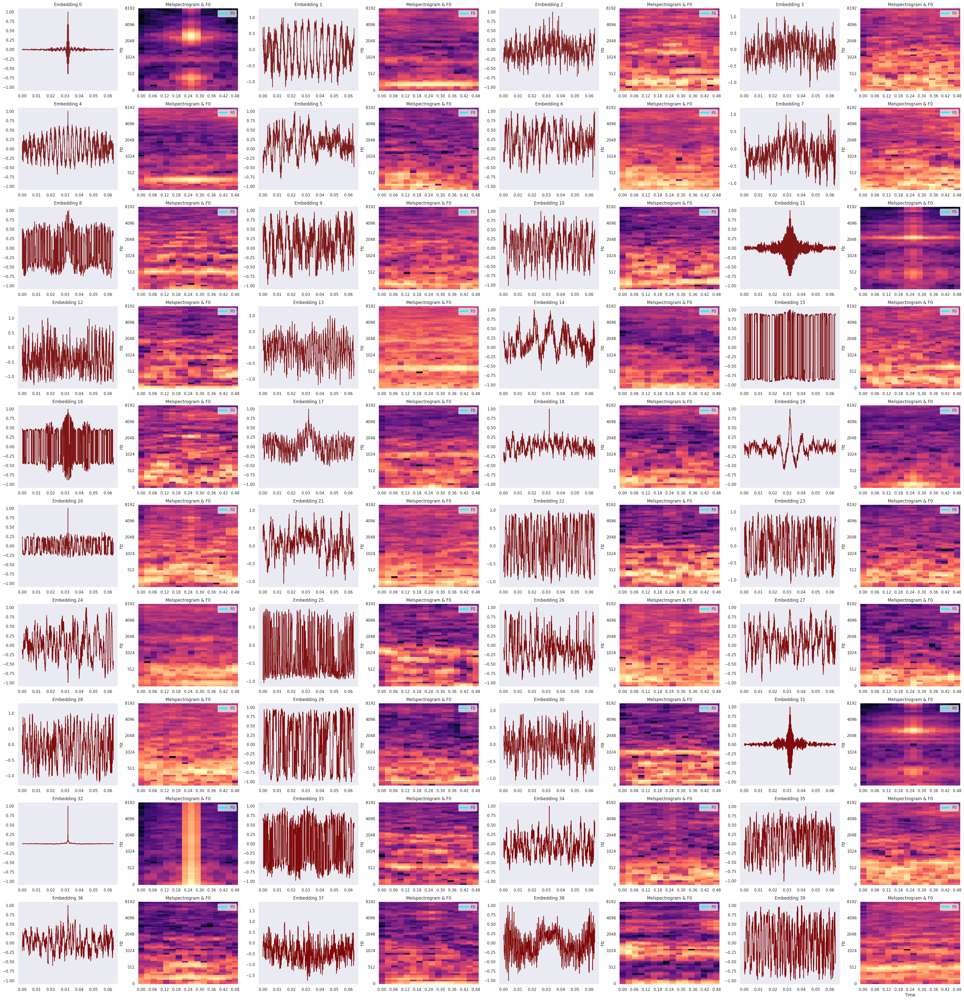

In [60]:
selected_idx = torch.topk(zcs2, 160).indices[-40:]
visualize_speech_codebook(
    emb_data2[selected_idx].numpy(), 
    n=80, colors=emb_color2[selected_idx])

In [63]:
def get_zcs_color(zcs: Tensor):
    score_sig = torch.clamp(
        F.softplus(zcs, beta=40.0, threshold=0.5)*10, max=1)
    color = torch.stack(
        [1-score_sig, torch.full_like(zcs, 0.5), score_sig], 
        dim=-1).numpy()
    return color

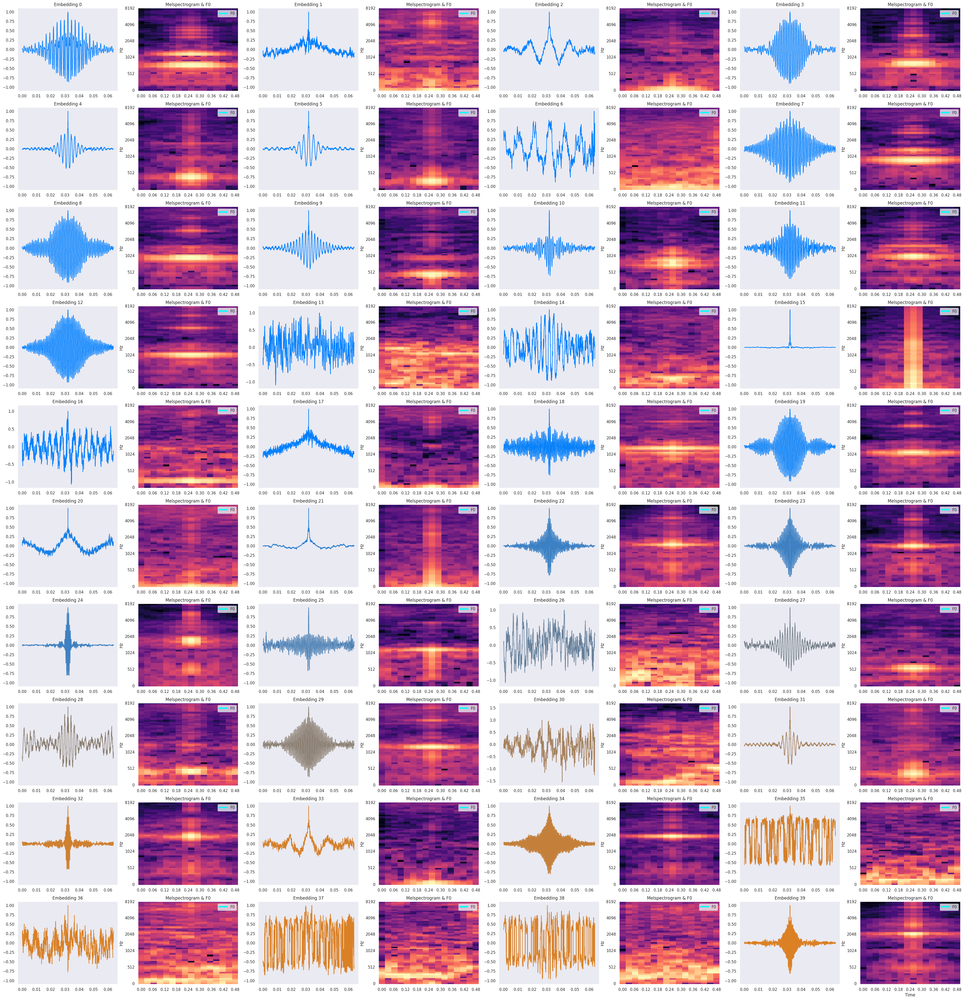

In [65]:
selected_topk = torch.topk(zcs2, 120)
selected_idx = selected_topk.indices[-40:]
selected_color = get_zcs_color(selected_topk.values[-40:])
visualize_speech_codebook(
    emb_data2[selected_idx].numpy(), 
    n=80, colors=selected_color)

In [68]:
from einops import reduce
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

<Axes: >

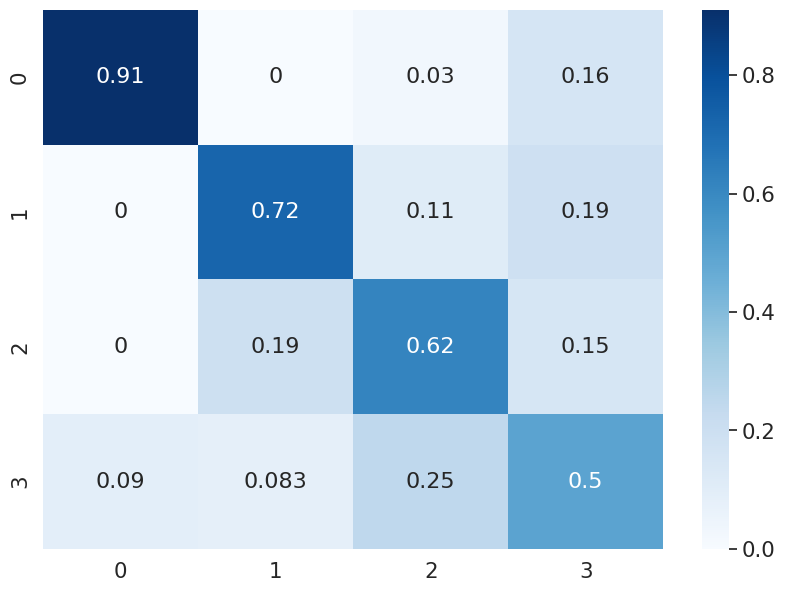

In [70]:
a = torch.tensor(
    [[25,  0,  1,  6],
    [ 0, 12,  2,  4],
    [ 0,  7, 25,  7],
    [ 3,  3, 10, 23]], dtype=torch.float)
a /= reduce(a, 'y yh -> y 1', 'sum')
a /= reduce(a, 'y yh -> 1 yh', 'sum')
df_cm = pd.DataFrame(a, columns=labels, index = labels)
df_cm.index.name = 'Actual'
df_cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sns.set(font_scale=1.4) #for label size
sns.heatmap(
    a, cmap="Blues", 
    annot=True,
    annot_kws={"size": 16})# font size

In [74]:
from IConNet.acov.audio_viz import (
    feature_librosa, play_and_visualize, show_feature)
from IConNet.acov.audio import AudioLibrosa

def display_embedding(
    i, emb_np, title_prefix="Voiced ", 
    sr=16000):
    title=f'{title_prefix}Embedding {i}'
    audio_top = AudioLibrosa(
        y=emb_np[i], 
        sr=sr, title=title,
        win_length=256
    )
    audio_top.extract_features()
    print(title)
    show_feature(audio_top)
    display(audio_top.player)

Voiced Embedding 52



Voiced Embedding 314



Voiced Embedding 284



Voiced Embedding 300



Voiced Embedding 309



Voiced Embedding 134



Voiced Embedding 182



Voiced Embedding 370



Voiced Embedding 162



Voiced Embedding 133



Voiced Embedding 225



Voiced Embedding 40



Voiced Embedding 190



Voiced Embedding 228



Voiced Embedding 203



Voiced Embedding 255



Voiced Embedding 44



Voiced Embedding 160



Voiced Embedding 252



Voiced Embedding 169



Voiced Embedding 245



Voiced Embedding 216



Voiced Embedding 9



Voiced Embedding 270



Voiced Embedding 283



Voiced Embedding 55



Voiced Embedding 226



Voiced Embedding 131



Voiced Embedding 23



Voiced Embedding 100



Voiced Embedding 5



Voiced Embedding 148



Voiced Embedding 346



Voiced Embedding 60



Voiced Embedding 262



Voiced Embedding 111



Voiced Embedding 377



Voiced Embedding 376



Voiced Embedding 256



Voiced Embedding 221



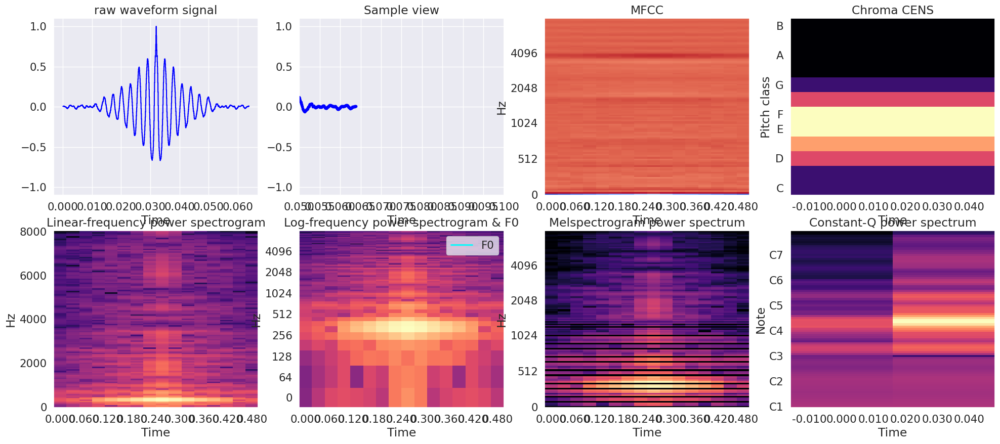

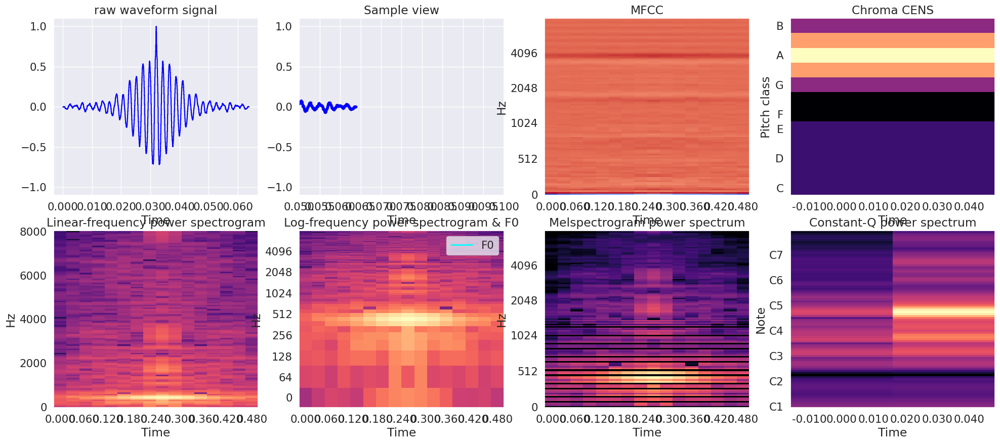

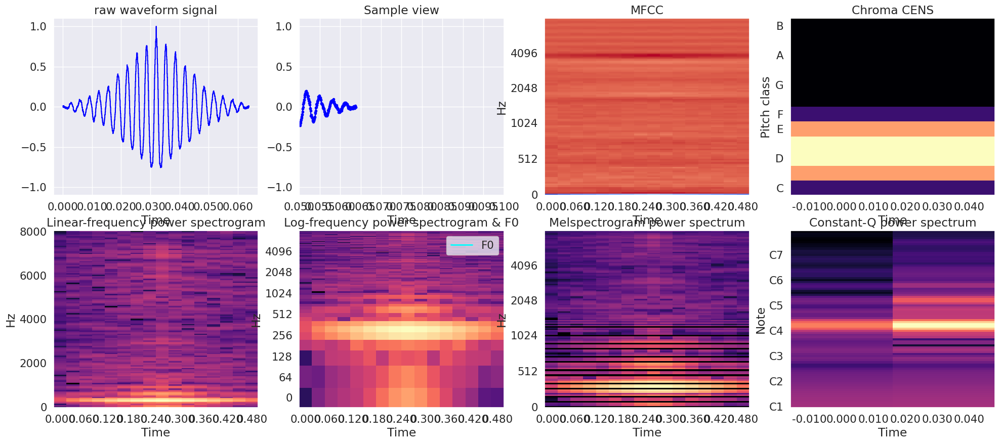

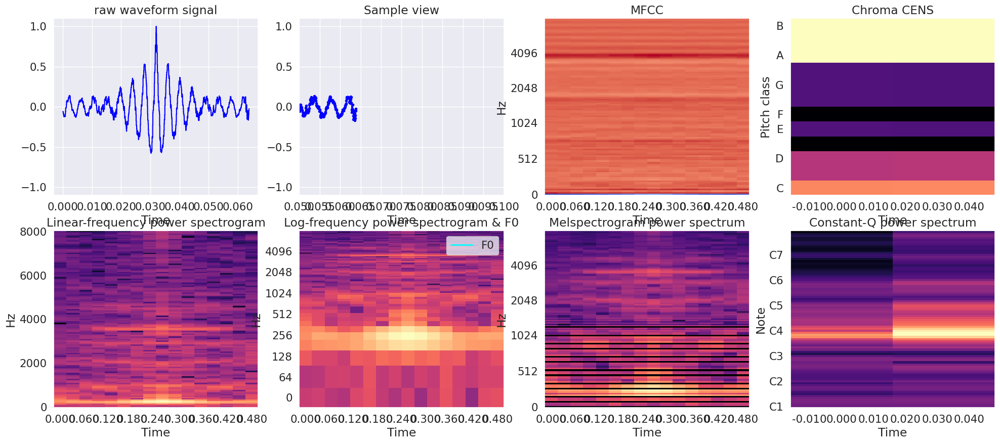

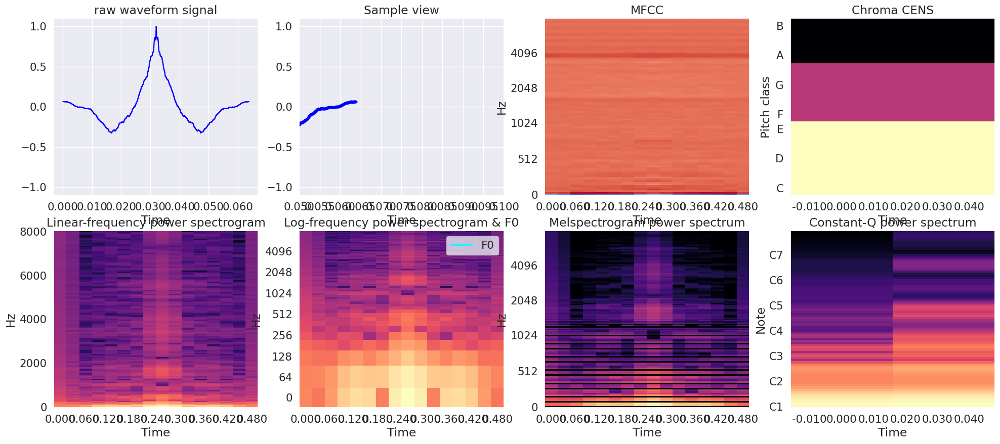

...

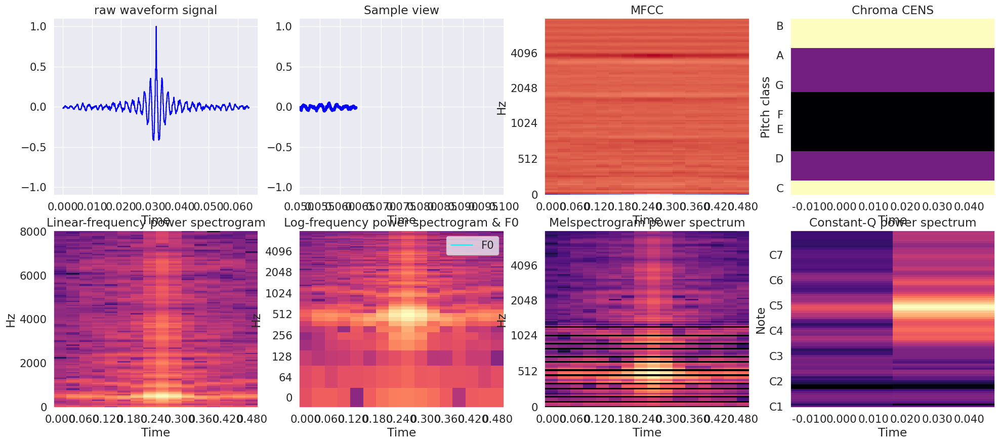

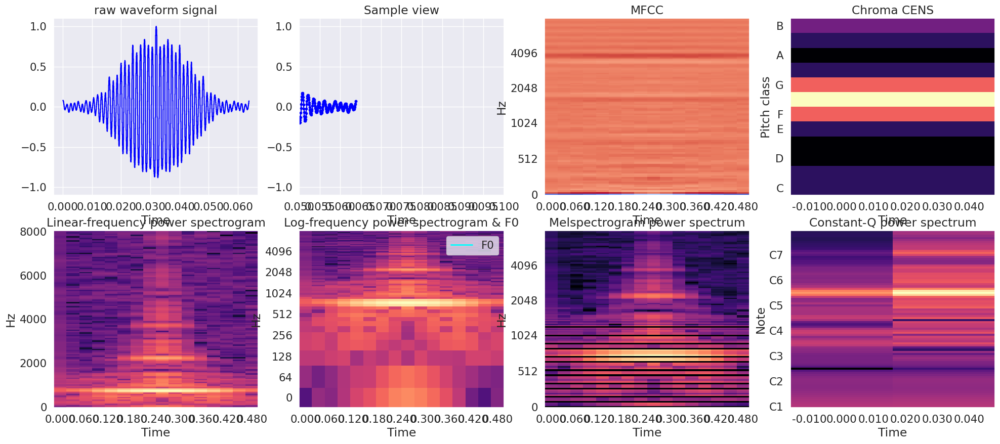

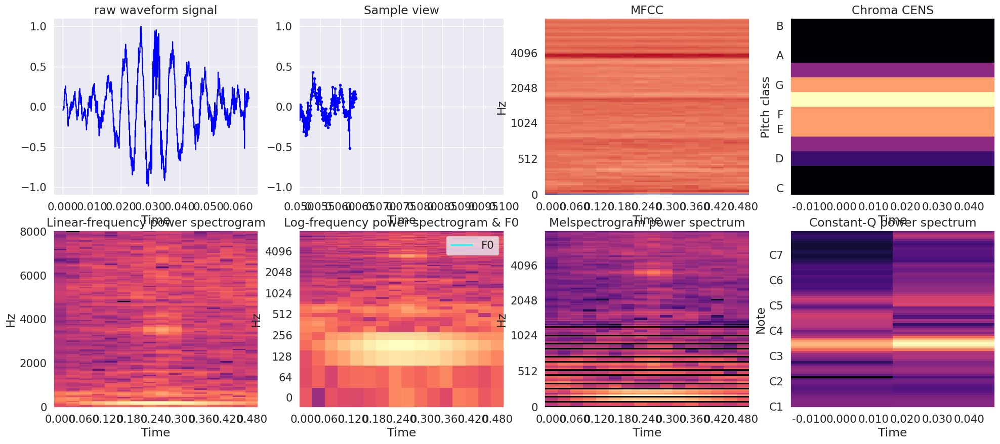

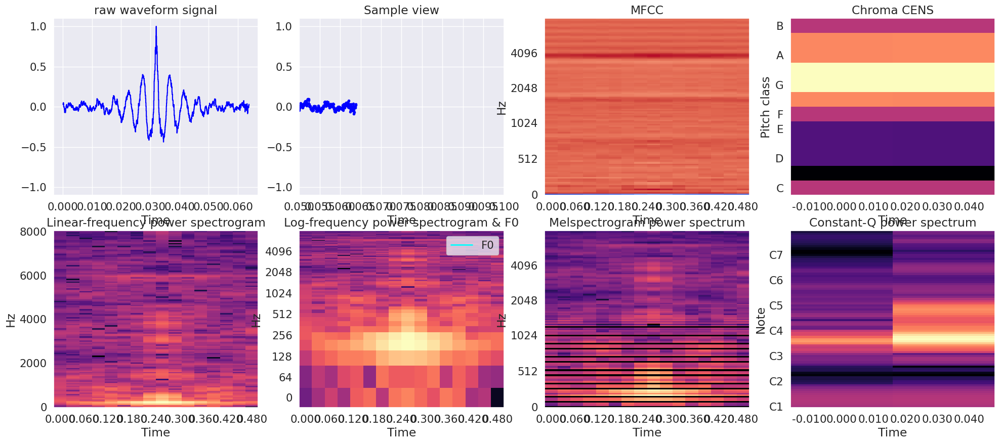

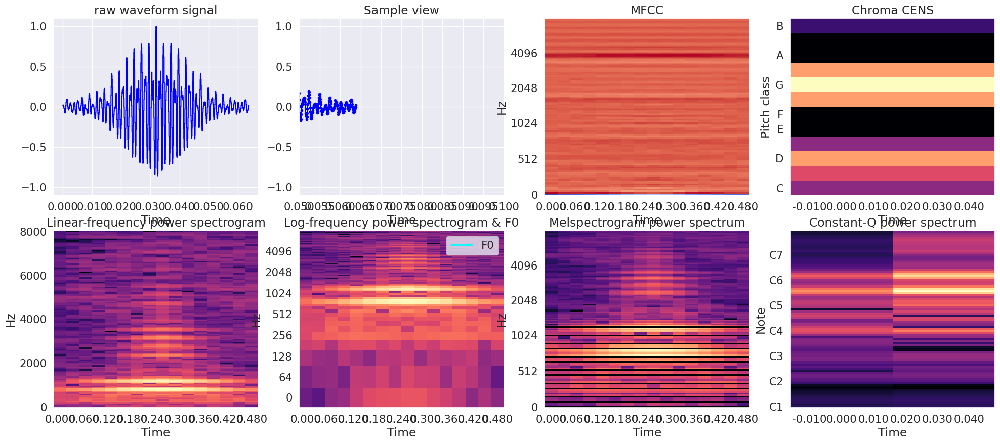

In [76]:
selected_idx = torch.topk(zcs2, 80).indices[40:]
emb_data2_np = emb_data2.numpy()
for ii in selected_idx:
    display_embedding(ii, emb_data2_np)